# Support Vector Machines and Decision Trees Project

### The Data
We will be using the dataset <em>tp5.csv</em>. 

This dataset contains 5000 cases and 13 features, including:

- city_name
- magnitude_of_delay
- delay_in_seconds
- affected_roads
- record_date
- luminosity
- avg_temperature
- avg_atm_pressure
- avg_humidity
- avg_wind_speed
- avg_precipitation
- avg_rain
- incidents

## Import Libraries

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

## Get the data

In [31]:
data = pd.read_csv('tp5.csv')

# Handling missing data and possible data transformations
- Remove missing values, outliers, and unnecessary rows/ columns
- Check and impute null values
- Check Imbalanced data
- Re-indexing and reformatting our data

In [32]:
data.isnull().sum()

city_name              0
magnitude_of_delay     0
delay_in_seconds       0
affected_roads        85
record_date            0
luminosity             0
avg_temperature        0
avg_atm_pressure       0
avg_humidity           0
avg_wind_speed         0
avg_precipitation      0
avg_rain               0
incidents              0
dtype: int64

<AxesSubplot:>

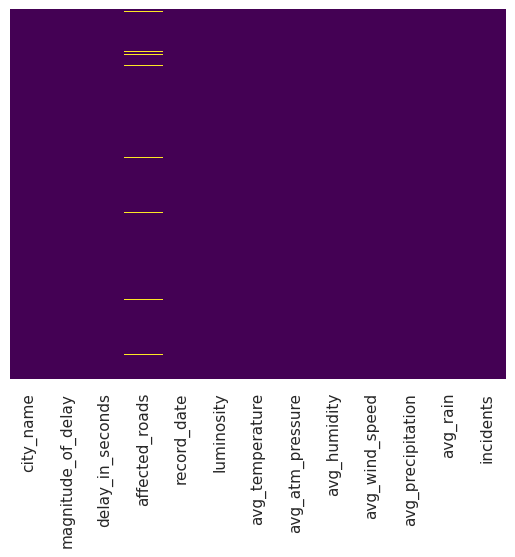

In [33]:
sns.heatmap(data.isnull(),yticklabels=False, cbar=False,cmap='viridis')

In [34]:
data.drop(['affected_roads'], axis = 1, inplace = True)

In [35]:
data.head()

,city_name,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_precipitation,avg_rain,incidents
0,Guimaraes,UNDEFINED,0,2021-03-15 23:00,DARK,12.0,1013.0,70.0,1.0,0.0,Sem Chuva,None
1,Guimaraes,UNDEFINED,385,2021-12-25 18:00,DARK,12.0,1007.0,91.0,1.0,0.0,Sem Chuva,None
2,Guimaraes,UNDEFINED,69,2021-03-12 15:00,LIGHT,14.0,1025.0,64.0,0.0,0.0,Sem Chuva,Low
3,Guimaraes,MAJOR,2297,2021-09-29 09:00,LIGHT,15.0,1028.0,75.0,1.0,0.0,Sem Chuva,Very_High
4,Guimaraes,UNDEFINED,0,2021-06-13 11:00,LIGHT,27.0,1020.0,52.0,1.0,0.0,Sem Chuva,High


In [36]:
data.nunique()

city_name                1
magnitude_of_delay       3
delay_in_seconds      1186
record_date           5000
luminosity               3
avg_temperature         35
avg_atm_pressure        36
avg_humidity            83
avg_wind_speed          11
avg_precipitation        1
avg_rain                 4
incidents                5
dtype: int64

In [37]:
data.drop(['avg_precipitation', 'city_name'], axis = 1, inplace = True)

In [38]:
data.dropna(inplace=True)

In [39]:
data.head()

,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_rain,incidents
0,UNDEFINED,0,2021-03-15 23:00,DARK,12.0,1013.0,70.0,1.0,Sem Chuva,None
1,UNDEFINED,385,2021-12-25 18:00,DARK,12.0,1007.0,91.0,1.0,Sem Chuva,None
2,UNDEFINED,69,2021-03-12 15:00,LIGHT,14.0,1025.0,64.0,0.0,Sem Chuva,Low
3,MAJOR,2297,2021-09-29 09:00,LIGHT,15.0,1028.0,75.0,1.0,Sem Chuva,Very_High
4,UNDEFINED,0,2021-06-13 11:00,LIGHT,27.0,1020.0,52.0,1.0,Sem Chuva,High


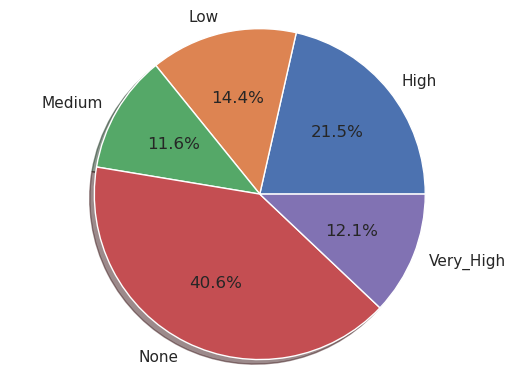

In [40]:
labels = data['incidents'].astype('category').cat.categories.tolist()
counts = data['incidents'].value_counts()

sizes = [counts[var_cat] for var_cat in labels]

fig, axl = plt.subplots()

axl.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True) #autopct is show the ¥ on plot
axl. axis('equal')

plt.show()


/home/miguel/miniconda3/envs/daa/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


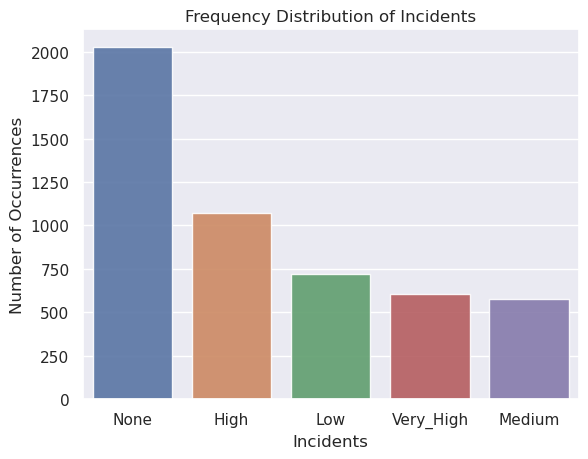

In [41]:
incidents_count = data['incidents'].value_counts()
sns.set(style="darkgrid")

sns.barplot(incidents_count.index, incidents_count.values, alpha=0.9)
plt.title('Frequency Distribution of Incidents')

plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Incidents', fontsize=12)

plt.show()

In [26]:
 replace_map = {'incidents': {'None': 0, 'Low': 1, 'Medium': 1, 'High' : 3, 'Very_High':4}}

In [29]:
data.head()

,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_rain,incidents
0,UNDEFINED,0,2021-03-15 23:00,DARK,12.0,1013.0,70.0,1.0,Sem Chuva,None
1,UNDEFINED,385,2021-12-25 18:00,DARK,12.0,1007.0,91.0,1.0,Sem Chuva,None
2,UNDEFINED,69,2021-03-12 15:00,LIGHT,14.0,1025.0,64.0,0.0,Sem Chuva,Low
3,MAJOR,2297,2021-09-29 09:00,LIGHT,15.0,1028.0,75.0,1.0,Sem Chuva,Very_High
4,UNDEFINED,0,2021-06-13 11:00,LIGHT,27.0,1020.0,52.0,1.0,Sem Chuva,High


In [42]:
data.replace(replace_map, inplace = True)
data.head()

,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_rain,incidents
0,UNDEFINED,0,2021-03-15 23:00,DARK,12.0,1013.0,70.0,1.0,Sem Chuva,0
1,UNDEFINED,385,2021-12-25 18:00,DARK,12.0,1007.0,91.0,1.0,Sem Chuva,0
2,UNDEFINED,69,2021-03-12 15:00,LIGHT,14.0,1025.0,64.0,0.0,Sem Chuva,1
3,MAJOR,2297,2021-09-29 09:00,LIGHT,15.0,1028.0,75.0,1.0,Sem Chuva,4
4,UNDEFINED,0,2021-06-13 11:00,LIGHT,27.0,1020.0,52.0,1.0,Sem Chuva,3


In [50]:
data['avg_rain'].unique()

array(['Sem Chuva', 'chuva moderada', 'chuva fraca', 'chuva forte'],
      dtype=object)

In [52]:
replace_map_rain = {'avg_rain': {'Sem Chuva' : 0, 'chuva frava' : 1, 'chuva moderada' : 2, 'chuva forte' : 3}}

In [53]:
data.replace(replace_map_rain, inplace = True)
data.head()

,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_rain,incidents
0,UNDEFINED,0,2021-03-15 23:00,DARK,12.0,1013.0,70.0,1.0,0,0
1,UNDEFINED,385,2021-12-25 18:00,DARK,12.0,1007.0,91.0,1.0,0,0
2,UNDEFINED,69,2021-03-12 15:00,LIGHT,14.0,1025.0,64.0,0.0,0,1
3,MAJOR,2297,2021-09-29 09:00,LIGHT,15.0,1028.0,75.0,1.0,0,4
4,UNDEFINED,0,2021-06-13 11:00,LIGHT,27.0,1020.0,52.0,1.0,0,3


In [54]:
data['luminosity'].unique()

array(['DARK', 'LIGHT', 'LOW_LIGHT'], dtype=object)

In [56]:
replace_map_luminosity = {'luminosity': {'LOW_LIGHT' : 0, 'LIGHT' : 1, 'DARK' : 2}}

In [57]:
data.replace(replace_map_luminosity, inplace = True)
data.head()

,magnitude_of_delay,delay_in_seconds,record_date,luminosity,avg_temperature,avg_atm_pressure,avg_humidity,avg_wind_speed,avg_rain,incidents
0,UNDEFINED,0,2021-03-15 23:00,2,12.0,1013.0,70.0,1.0,0,0
1,UNDEFINED,385,2021-12-25 18:00,2,12.0,1007.0,91.0,1.0,0,0
2,UNDEFINED,69,2021-03-12 15:00,1,14.0,1025.0,64.0,0.0,0,1
3,MAJOR,2297,2021-09-29 09:00,1,15.0,1028.0,75.0,1.0,0,4
4,UNDEFINED,0,2021-06-13 11:00,1,27.0,1020.0,52.0,1.0,0,3


# Exploratory Data Analysis

Time to put your data viz skills to the test! Try to recreate the following plots, make sure to import the libraries you'll need!

In [ ]:
...

# Train Test Split

** Split your data into a training set and a testing set.**

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
...

# Train a Model

Now its time to train a Support Vector Machine Classifier. 

**Call the SVC() model from sklearn and fit the model to the training data.**

In [ ]:
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree

In [ ]:
...

SVC(random_state=2022)

In [ ]:
...

DecisionTreeClassifier(random_state=2022)

1. Plot the resultant tree (plot_tree) and save it as figure (.png)

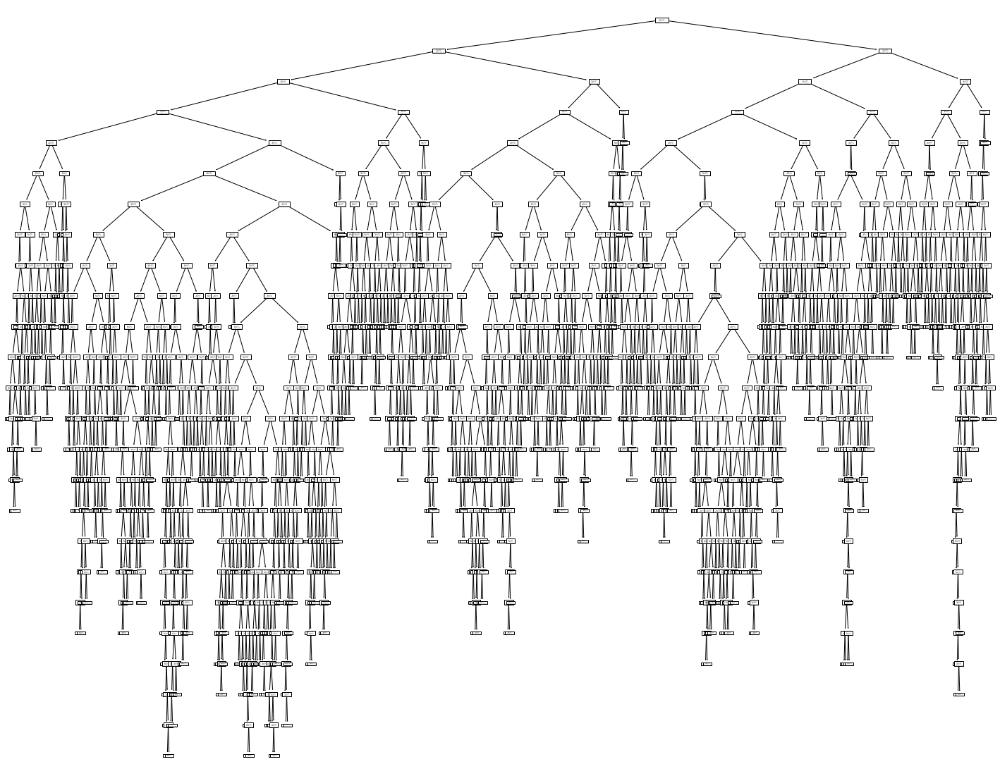

In [ ]:
...

2. Use export_text to reprent the tree. Save it in a log file

In [ ]:
...

|--- feature_1 <= 25.00
|   |--- feature_4 <= 1020.50
|   |   |--- feature_5 <= 91.50
|   |   |   |--- feature_4 <= 1011.50
|   |   |   |   |--- feature_3 <= 15.50
|   |   |   |   |   |--- feature_3 <= 11.50
|   |   |   |   |   |   |--- feature_6 <= 1.50
|   |   |   |   |   |   |   |--- feature_4 <= 1002.00
|   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- feature_4 >  1002.00
|   |   |   |   |   |   |   |   |--- feature_3 <= 10.50
|   |   |   |   |   |   |   |   |   |--- feature_2 <= 1.50
|   |   |   |   |   |   |   |   |   |   |--- feature_7 <= 1.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 6
|   |   |   |   |   |   |   |   |   |   |--- feature_7 >  1.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 3
|   |   |   |   |   |   |   |   |   |--- feature_2 >  1.50
|   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- feature_3 >  10.50
|   |   |   |   |   |   |  

3. Use graphviz to visualize the tree (export_graphviz). Save it in a file

In [4]:
!pip install graphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 906.6 kB/s eta 0:00:00 0:00:01


In [ ]:
...

In [ ]:
...

'dt_graphviz.pdf'

In [ ]:
...

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.336458 to fit


'dt_graphviz.png'

4. Use dtreeviz to visualize the tree and save it as svg file

In [ ]:
#!pip install dtreeviz

In [ ]:
...

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


In [ ]:
...

## Model Evaluation - SVM and DT

**Now get predictions from the model and create a confusion matrix and a classification report.**

In [ ]:
...

In [ ]:
from sklearn.metrics import classification_report, plot_confusion_matrix

Support Vector Machine

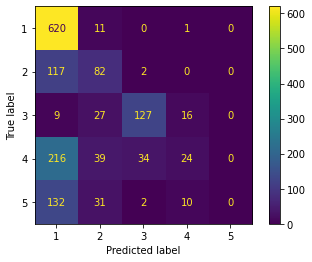

In [ ]:
...

In [ ]:
...

              precision    recall  f1-score   support

           1       0.57      0.98      0.72       632
           2       0.43      0.41      0.42       201
           3       0.77      0.71      0.74       179
           4       0.47      0.08      0.13       313
           5       0.00      0.00      0.00       175

    accuracy                           0.57      1500
   macro avg       0.45      0.44      0.40      1500
weighted avg       0.49      0.57      0.47      1500



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Decision Tree Classifier

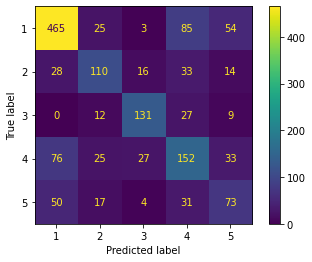

In [ ]:
...

In [ ]:
...

              precision    recall  f1-score   support

           1       0.75      0.74      0.74       632
           2       0.58      0.55      0.56       201
           3       0.72      0.73      0.73       179
           4       0.46      0.49      0.47       313
           5       0.40      0.42      0.41       175

    accuracy                           0.62      1500
   macro avg       0.58      0.58      0.58      1500
weighted avg       0.62      0.62      0.62      1500



Wow! You should have noticed that your model was pretty good! Let's see if we can tune the parameters to try to get even better (unlikely, and you probably would be satisfied with these results in real like because the data set is quite small, but I just want you to practice using GridSearch.

## Gridsearch Practice

In [ ]:
from sklearn.model_selection import GridSearchCV

**Create a dictionary called param_grid and fill out some parameters for C and gamma.**

Support Vector Machine

In [ ]:
...

Fitting 5 folds for each of 32 candidates, totalling 160 fits
[CV] C=0.1, gamma=1, kernel=rbf ......................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ....................... C=0.1, gamma=1, kernel=rbf, total=   0.7s
[CV] C=0.1, gamma=1, kernel=rbf ......................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s remaining:    0.0s


[CV] ....................... C=0.1, gamma=1, kernel=rbf, total=   0.7s
[CV] C=0.1, gamma=1, kernel=rbf ......................................
[CV] ....................... C=0.1, gamma=1, kernel=rbf, total=   0.6s
[CV] C=0.1, gamma=1, kernel=rbf ......................................
[CV] ....................... C=0.1, gamma=1, kernel=rbf, total=   0.6s
[CV] C=0.1, gamma=1, kernel=rbf ......................................
[CV] ....................... C=0.1, gamma=1, kernel=rbf, total=   0.6s
[CV] C=0.1, gamma=1, kernel=linear ...................................
[CV] .................... C=0.1, gamma=1, kernel=linear, total= 1.5min
[CV] C=0.1, gamma=1, kernel=linear ...................................


Decision Tree Classifier

In [ ]:
...

24
1189


In [ ]:
...

Fitting 5 folds for each of 22 candidates, totalling 110 fits
[CV] criterion=gini, max_depth=0 .....................................
[CV] ...................... criterion=gini, max_depth=0, total=   0.0s
[CV] criterion=gini, max_depth=0 .....................................
[CV] ...................... criterion=gini, max_depth=0, total=   0.0s
[CV] criterion=gini, max_depth=0 .....................................
[CV] ...................... criterion=gini, max_depth=0, total=   0.0s
[CV] criterion=gini, max_depth=0 .....................................
[CV] ...................... criterion=gini, max_depth=0, total=   0.0s
[CV] criterion=gini, max_depth=0 .....................................
[CV] ...................... criterion=gini, max_depth=0, total=   0.0s
[CV] criterion=gini, max_depth=1 .....................................
[CV] ...................... criterion=gini, max_depth=1, total=   0.0s
[CV] criterion=gini, max_depth=1 .....................................
[CV] ..........

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 277, in fit
    raise ValueError("max_depth must be greater than zero. ")
ValueError: max_depth must be greater than zero. 

  FitFailedWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:5

[CV] ...................... criterion=gini, max_depth=4, total=   0.0s
[CV] criterion=gini, max_depth=4 .....................................
[CV] ...................... criterion=gini, max_depth=4, total=   0.0s
[CV] criterion=gini, max_depth=4 .....................................
[CV] ...................... criterion=gini, max_depth=4, total=   0.0s
[CV] criterion=gini, max_depth=5 .....................................
[CV] ...................... criterion=gini, max_depth=5, total=   0.0s
[CV] criterion=gini, max_depth=5 .....................................
[CV] ...................... criterion=gini, max_depth=5, total=   0.0s
[CV] criterion=gini, max_depth=5 .....................................
[CV] ...................... criterion=gini, max_depth=5, total=   0.0s
[CV] criterion=gini, max_depth=5 .....................................
[CV] ...................... criterion=gini, max_depth=5, total=   0.0s
[CV] criterion=gini, max_depth=5 .....................................
[CV] .

/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 277, in fit
    raise ValueError("max_depth must be greater than zero. ")
ValueError: max_depth must be greater than zero. 

  FitFailedWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call

[CV] ................... criterion=entropy, max_depth=4, total=   0.0s
[CV] criterion=entropy, max_depth=4 ..................................
[CV] ................... criterion=entropy, max_depth=4, total=   0.0s
[CV] criterion=entropy, max_depth=4 ..................................
[CV] ................... criterion=entropy, max_depth=4, total=   0.0s
[CV] criterion=entropy, max_depth=4 ..................................
[CV] ................... criterion=entropy, max_depth=4, total=   0.0s
[CV] criterion=entropy, max_depth=5 ..................................
[CV] ................... criterion=entropy, max_depth=5, total=   0.0s
[CV] criterion=entropy, max_depth=5 ..................................
[CV] ................... criterion=entropy, max_depth=5, total=   0.0s
[CV] criterion=entropy, max_depth=5 ..................................
[CV] ................... criterion=entropy, max_depth=5, total=   0.0s
[CV] criterion=entropy, max_depth=5 ..................................
[CV] .

[Parallel(n_jobs=1)]: Done 110 out of 110 | elapsed:    1.0s finished


GridSearchCV(estimator=DecisionTreeClassifier(random_state=2022),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]},
             verbose=2)

** Now take that grid model and create some predictions using the test set and create classification reports and confusion matrices for them. Were you able to improve?**

Support Vector Machine

In [ ]:
...

In [ ]:
...

Decision Tree Classifier

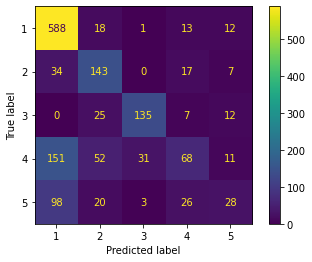

In [ ]:
...

In [ ]:
...

              precision    recall  f1-score   support

           1       0.68      0.93      0.78       632
           2       0.55      0.71      0.62       201
           3       0.79      0.75      0.77       179
           4       0.52      0.22      0.31       313
           5       0.40      0.16      0.23       175

    accuracy                           0.64      1500
   macro avg       0.59      0.55      0.54      1500
weighted avg       0.61      0.64      0.60      1500



## Prunnig

Decision Tree Classifier

In [ ]:
...

24
1189


#### Best Depth Tree

Max_depth

In [ ]:
...

24

Model with DecisionTreeClassifier using GridSearchCV. Max_depth as param_grid

In [ ]:
...

Best_params_

In [ ]:
...

Best_estimator

In [ ]:
...

Best_max_depth

In [ ]:
...

Evaluate the model with confusion matrix  and classification report

In [ ]:
...

In [ ]:
...

#### Pruned Tree

Define the ccp_alphas

In [ ]:
...

In [ ]:
...

array([0.00000000e+00, 1.90476190e-05, 2.38095238e-05, 3.78151261e-05,
       4.76190476e-05, 6.66666667e-05, 7.14285714e-05, 7.14285714e-05,
       7.61904762e-05, 7.61904762e-05, 8.57142857e-05, 9.52380952e-05,
       9.52380952e-05, 9.52380952e-05, 9.52380952e-05, 9.52380952e-05,
       1.08843537e-04, 1.14285714e-04, 1.22448980e-04, 1.36645963e-04,
       1.39097744e-04, 1.40394089e-04, 1.42857143e-04, 1.58730159e-04,
       1.59663866e-04, 1.61904762e-04, 1.63265306e-04, 1.70068027e-04,
       1.71428571e-04, 1.71428571e-04, 1.71428571e-04, 1.72397220e-04,
       1.74603175e-04, 1.74603175e-04, 1.75824176e-04, 1.77777778e-04,
       1.79271709e-04, 1.80952381e-04, 1.82539683e-04, 1.82857143e-04,
       1.90476190e-04, 1.90476190e-04, 1.90476190e-04, 1.90476190e-04,
       1.90476190e-04, 1.90476190e-04, 1.90476190e-04, 1.90476190e-04,
       1.90476190e-04, 1.90476190e-04, 1.90476190e-04, 1.90476190e-04,
       2.11640212e-04, 2.11640212e-04, 2.11764706e-04, 2.14285714e-04,
      

Get the keys of parameters for estimator

In [ ]:
...

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'presort', 'random_state', 'splitter'])

Model with DecisionTreeClassifier using GridSearchCV. Ccp_alpha as param_grid

In [ ]:
...

Best_params_

In [ ]:
...

Best_estimator_

In [ ]:
...

Evaluate the model with confusion matrix  and classification report

In [ ]:
...

In [ ]:
...